In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.patches as mpatches

###parameters
normalisation_cutoff = 0.1
graph_type = 'directional'


In [2]:
# Import the input-output table, with multi-indices for both index and columns: one for country, another for sector
input_output = pd.read_csv("input_output.csv", index_col = [0,1], header = [0,1])
input_out = pd.read_csv("input_output.csv", index_col = [0,1], header = [0,1])



In [3]:
def normalize(df, cutoff=0):
    result = df.copy()
    for feature_name in df.columns:
        total = df[feature_name].sum()
        if total == 0:
            result = result.drop(feature_name,1)
            result = result.drop(feature_name,0)
        else: 
            result[feature_name] = df[feature_name] / total
    result[result<cutoff] = 0
    return result 

In [4]:
#normalize(input_output)

In [18]:
input_output_norm = normalize(input_output, 0.1)
input_output_norm[input_output_norm<normalisation_cutoff] = 0

input_output_matrix = input_output_norm.as_matrix()
G = nx.from_numpy_matrix(input_output_matrix)

In [7]:
#plot distributions based on different 
low = normalize(input_out,0.01)
mid_low = normalize(input_out,0.05)
mid = normalize(input_out,0.1)
mid_high = normalize(input_out,0.2)
high = normalize(input_out,0.3)

In [48]:
len(np.histogram(low))
[len(i) for i in np.histogram(low)]

[10, 11]

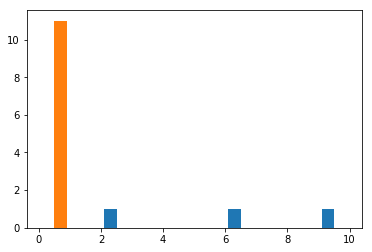

In [45]:
plt.hist(np.histogram(low), bins=10, range =(0,10))
plt.show()

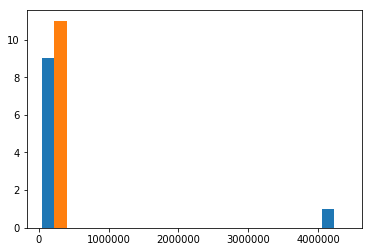

In [36]:
plt.hist(np.histogram(mid_low))
plt.show()

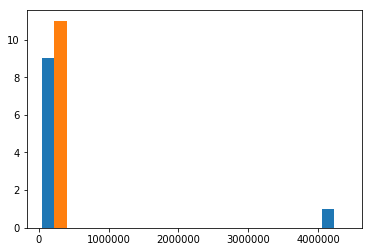

In [37]:
plt.hist(np.histogram(mid))
plt.show()

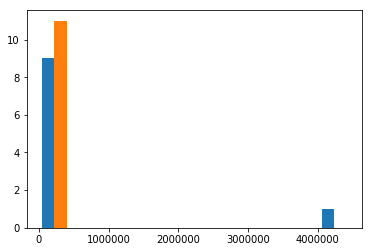

In [38]:
plt.hist(np.histogram(mid_high))
plt.show()

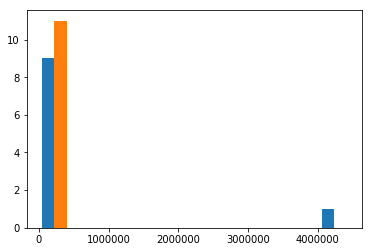

In [39]:
plt.hist(np.histogram(high))
plt.show()

In [8]:
#outdegree list
out_ = np.sum(input_output_norm, axis=1)

#add attributes of country and sector to each node
for node in G.nodes():
    G.node[node]['country'] = list(input_output_norm.index[node])[0]
    G.node[node]['sector'] = list(input_output_norm.index[node])[1]
    G.node[node]['outdegree'] = out_[node]

#prepare the sample network object
#France, Britain, Germany, Spain, Romania, cyprus

smpl_cntrs = ['FRA','GBR','DEU','ESP', 'ROU', 'CYP']
#smpl_cntrs = ['FRA','GBR','DEU']
#smpl_cntrs = ['FRA', 'GBR']
index_sample = input_output_norm.loc[smpl_cntrs]
col_idx_sample = index_sample[smpl_cntrs]
sample_matrix = col_idx_sample.as_matrix()

sample_out = np.sum(col_idx_sample, axis=1) 
sample_betweeness_centrality = nx.edge_betweenness_centrality(G)

D = nx.DiGraph(sample_matrix)
#D = nx.Graph(sample_matrix)

for node in D.nodes():
    D.node[node]['country'] = list(col_idx_sample.index[node])[0]
    D.node[node]['sector'] = list(col_idx_sample.index[node])[1]
    D.node[node]['outdegree'] = sample_out[node]
    D.node[node]['betweeness_centrality'] = sample_betweeness_centrality.values()[node]

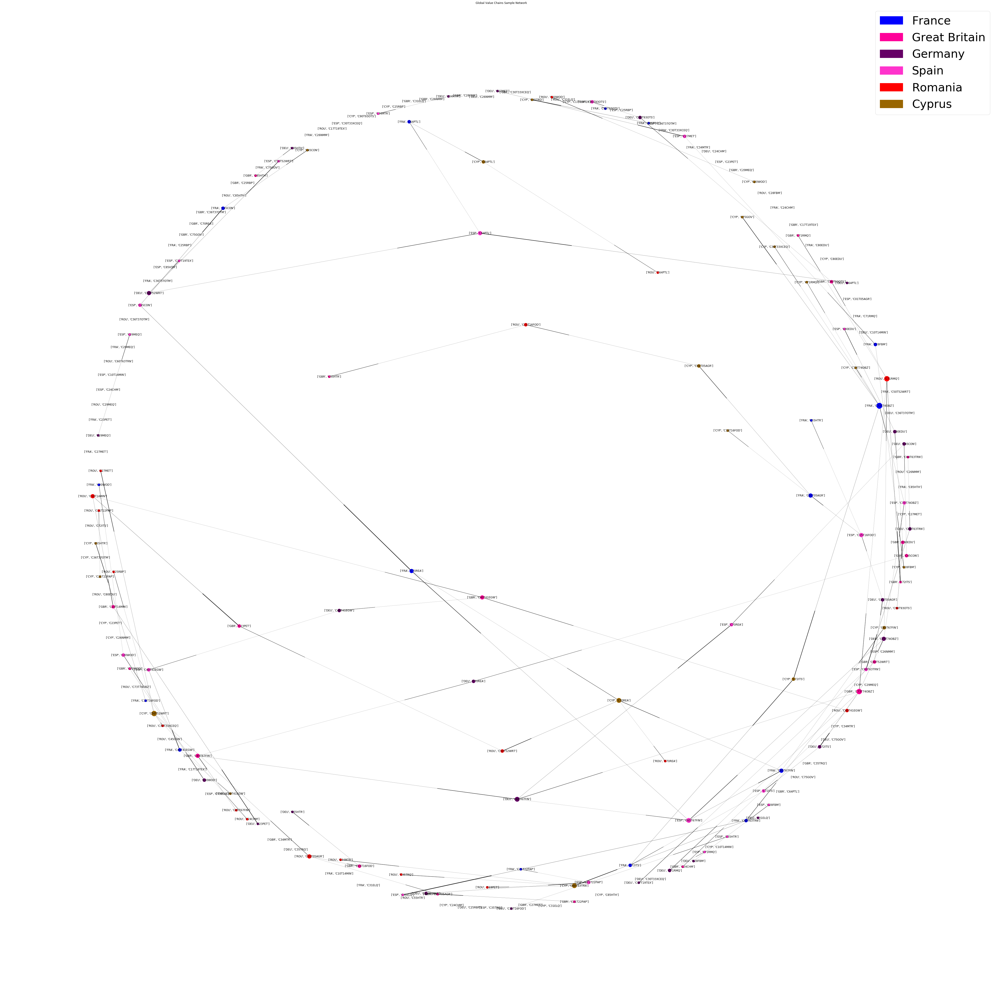

In [23]:
weights = nx.get_edge_attributes(D, 'weight').values()
color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

#color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066' }
d = nx.degree(D)

community_index = gn_partitions[1]
sectors = nx.get_node_attributes(D, 'sector').values()
country = nx.get_node_attributes(D, 'country').values()
cnt_sec = []
for i,j in zip(country,sectors):
    a = [i,j]
    cnt_sec.append(a)
for i,node in enumerate(D.nodes()):
    D.node[node]['cnt_sec'] = cnt_sec[i]

map_labels = nx.get_node_attributes(D, 'cnt_sec')  

pos = nx.spring_layout(D)
plt.figure(figsize = (60,60))

nx.draw(D, width = weights*20,labels =map_labels ,node_color = [color_map[D.node[node]['country']] for node in D],node_size=[v * 100 for v in d.values()])
plt.title('Global Value Chains Sample Network')

france = mpatches.Patch(color = 'b', label = 'France')
britain =  mpatches.Patch(color = '#FF0099', label = 'Great Britain')
germany =  mpatches.Patch(color = '#660066', label = 'Germany')
spain = mpatches.Patch(color = '#FF33CC', label = 'Spain')
romania = mpatches.Patch(color = 'r', label = 'Romania')
cyprus = mpatches.Patch(color='#996600', label='Cyprus')

plt.legend(handles=[france, britain, germany,spain,romania,cyprus], prop={'size':50})
plt.savefig('6 countreis complete graph.png')
plt.show()


In [12]:
#girvan newman allgorythm

def girvan_newman(G, most_valuable_edge=None, min_edges = 0):
# If the graph is already empty, simply return its connected
    # components.
    if G.number_of_edges() == 0:
        yield tuple(nx.connected_components(G))
        return
    # If no function is provided for computing the most valuable edge,
    # use the edge betweenness centrality.
    if most_valuable_edge is None:
        def most_valuable_edge(G):
            """Returns the edge with the highest betweenness centrality
            in the graph `G`.

            """
            # We have guaranteed that the graph is non-empty, so this
            # dictionary will never be empty.
            betweenness = nx.edge_betweenness_centrality(G)
            return max(betweenness, key=betweenness.get)
    # The copy of G here must include the edge weight data.
    g = G.copy().to_undirected()
    # Self-loops must be removed because their removal has no effect on
    # the connected components of the graph.
    g.remove_edges_from(g.selfloop_edges())
    while g.number_of_edges() > min_edges:
        yield _without_most_central_edges(g, most_valuable_edge)

        
def _without_most_central_edges(G, most_valuable_edge):
    original_num_components = nx.number_connected_components(G)
    num_new_components = original_num_components
    while num_new_components <= original_num_components:
        edge = most_valuable_edge(G)
        G.remove_edge(*edge)
        new_components = tuple(nx.connected_components(G))
        num_new_components = len(new_components)
    return new_components


In [13]:
def create_graph_for_year(year):
    input_output = pd.read_csv("~/Dropbox/school/test/Networks/ICIO_data/ICIO2016_" + str(year) + ".csv", index_col = [0,1], header = [0,1])
    input_output_norm = input_output
    input_output_norm[input_output_norm < 50000] = 0
    #input_output_norm = normalize(input_output)
    #input_output_norm[input_output_norm<0.2] = 0
    #prepare the sample network object
    #France, Britain, Germany, Spain, Romania, cyprus
    smpl_cntrs = ['FRA','GBR','DEU','ESP', 'ROU', 'CYP']
    #smpl_cntrs = ['FRA','GBR']
    index_sample = input_output_norm.loc[smpl_cntrs]
    col_idx_sample = index_sample[smpl_cntrs]
    sample_matrix = col_idx_sample.as_matrix()
    D = nx.DiGraph(sample_matrix)
    for node in D.nodes():
        D.node[node]['country'] = list(col_idx_sample.index[node])[0]
        D.node[node]['sector'] = list(col_idx_sample.index[node])[1]
    return D

In [42]:
D = create_graph_for_year(2011)

In [14]:
gn_partition = girvan_newman(D, min_edges = 20)
gn_partitions = list(gn_partition)
community_index = [i for i in gn_partitions[1] if len(i) > 2]
avg_distinct_countries = []
for comm in community_index:
    subgraph_nodes = []
    for n in comm:
        subgraph_nodes.append(n)
    community = D.subgraph(subgraph_nodes)
    community.edges(data = True)
    old_nodes = community.nodes()
    new_nodes = list(range(len(community.nodes())))
    relabel_mapping = dict(zip(old_nodes, new_nodes))
    community = nx.relabel_nodes(community, relabel_mapping)
    out_nodes = [link[0] for link in community.edges()]
    in_nodes = [link[1] for link in community.edges()]
    in_countries = [nx.get_node_attributes(community, 'country')[node] for node in in_nodes]
    out_countries = [nx.get_node_attributes(community, 'country')[node] for node in out_nodes]
    distincts= []
    for outs,ins in zip(out_countries,in_countries):
        distincts.append(outs!=ins)
    distincts = sum(distincts)/len(community.edges())
    print(distincts)
    print(len(community.nodes()))

1
10
1
4
1
10
1
12
1
27
1
9
1
8
1
8
1
4
1
4
1
4


In [32]:
betweenness = nx.edge_betweenness_centrality(G)
max(betweenness, key=betweenness.get)

nx.number_connected_components(G)

1

In [195]:
print(D.number_of_edges(), 'edges')
print(D.number_of_nodes(), 'nodes')

(357, 'edges')
(198, 'nodes')


In [196]:
gn_partition = girvan_newman(D)
gn_partitions = list(gn_partition)

In [197]:
len(gn_partitions[1])

7

In [154]:
communities = [community for community in gn_partitions[6]]
#shapes = ['o','p','x','1','^','8','>','P']
#shapes = ['o','x','o','x','o','x','o']
#shapes = ['o','o','o','o','o','o','o']
shapes = ['r','b','g','c','m','y','k']

In [158]:
com_shapes = {}
for com,shape in zip(communities,shapes):
    for i in com:
        com_shapes[i] = shape
com_shapes


{0: 'r',
 1: 'b',
 2: 'r',
 3: 'b',
 4: 'b',
 5: 'b',
 6: 'b',
 7: 'b',
 8: 'b',
 9: 'b',
 10: 'g',
 11: 'b',
 12: 'g',
 13: 'b',
 14: 'g',
 15: 'g',
 16: 'b',
 17: 'g',
 18: 'c',
 19: 'b',
 20: 'r',
 21: 'c',
 22: 'm',
 23: 'c',
 24: 'c',
 25: 'c',
 26: 'b',
 27: 'y',
 28: 'c',
 29: 'b',
 30: 'b',
 31: 'b',
 32: 'b',
 33: 'y',
 34: 'r',
 35: 'y',
 36: 'y',
 37: 'r',
 38: 'y',
 39: 'k',
 40: 'y',
 41: 'r',
 42: 'y',
 43: 'g',
 46: 'y',
 47: 'y',
 49: 'y',
 50: 'y',
 51: 'r',
 52: 'y',
 53: 'y',
 54: 'y',
 55: 'y',
 56: 'y',
 57: 'y',
 58: 'y',
 59: 'y',
 60: 'y',
 61: 'y',
 62: 'r',
 63: 'y',
 64: 'y',
 65: 'y',
 66: 'y',
 67: 'y',
 68: 'y',
 69: 'y',
 70: 'y',
 71: 'y',
 72: 'b',
 73: 'b',
 74: 'y',
 75: 'y',
 76: 'g',
 77: 'g',
 79: 'y',
 80: 'y',
 82: 'y',
 83: 'y',
 84: 'b',
 85: 'y',
 86: 'b',
 87: 'y',
 88: 'b',
 89: 'y',
 90: 'y',
 91: 'y',
 92: 'y',
 93: 'y',
 94: 'b',
 95: 'y',
 96: 'y',
 97: 'y',
 98: 'y',
 99: 'b',
 100: 'b',
 101: 'b',
 102: 'b',
 103: 'b',
 104: 'b',
 105:

In [160]:
[color_map[D.node[node]['country']] for node in D]

['#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#996600',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#660066',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#FF33CC',
 '#F

In [152]:
#,node_color = [color_map[D.node[node]['country']] for node in D]
color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 
shape_map = {'FRA':'o', 'GBR':'x', 'DEU':'p', 'ESP': '1', 'ROU':'^', 'CYP':'P'}

In [150]:
[D.node for node in D]

AttributeError: 'dict' object has no attribute 'key'

In [161]:
weights = nx.get_edge_attributes(D, 'weight').values()
color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

#color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066' }
d = nx.degree(D)

community_index = gn_partitions[1]
sectors = nx.get_node_attributes(D, 'sector').values()
country = nx.get_node_attributes(D, 'country').values()
cnt_sec = []
for i,j in zip(country,sectors):
    a = [i,j]
    cnt_sec.append(a)
for i,node in enumerate(D.nodes()):
    D.node[node]['cnt_sec'] = cnt_sec[i]

map_labels = nx.get_node_attributes(D, 'cnt_sec')  


plt.figure(figsize = (120,120))

nx.draw(D, width = weights*20,labels =map_labels ,node_color = com_shapes.values(),node_size=[v * 100 for v in d.values()])
plt.title('Global Value Chains Sample Network')

#france = mpatches.Patch(color = 'b', label = 'France')
#britain =  mpatches.Patch(color = '#FF0099', label = 'Great Britain')
#germany =  mpatches.Patch(color = '#660066', label = 'Germany')
#spain = mpatches.Patch(color = '#FF33CC', label = 'Spain')
#romania = mpatches.Patch(color = 'r', label = 'Romania')
#cyprus = mpatches.Patch(color='#996600', label='Cyprus')

#plt.legend(handles=[france, britain, germany,spain,romania,cyprus], prop={'size':150})
plt.savefig('5countreis complete graph.png')
plt.show()

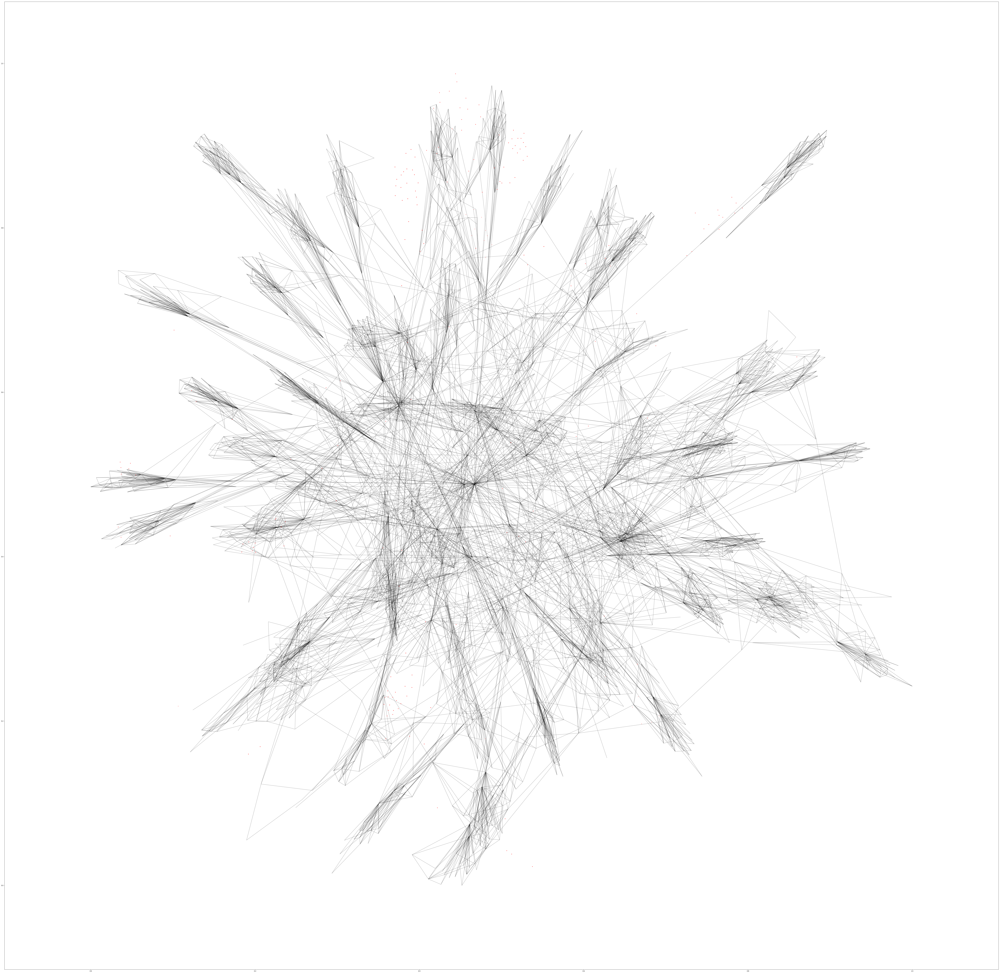

In [116]:
plt.figure(figsize = (120,120))

for idx,com in enumerate(communities):
    pos = nx.spring_layout(G)
    nx.draw_networkx_nodes(G,pos, nodelist=com,node_color='r',node_size=10, alpha=0.8, node_shape = shapes[idx], labels = map_labels)
nx.draw_networkx_edges(G,pos,width=1.0,alpha=0.5)
plt.show()



In [72]:
[len(communities) for i in communities]

[10, 10, 10, 10, 10, 10, 10, 10, 10, 10]

In [78]:
len(communities)

10

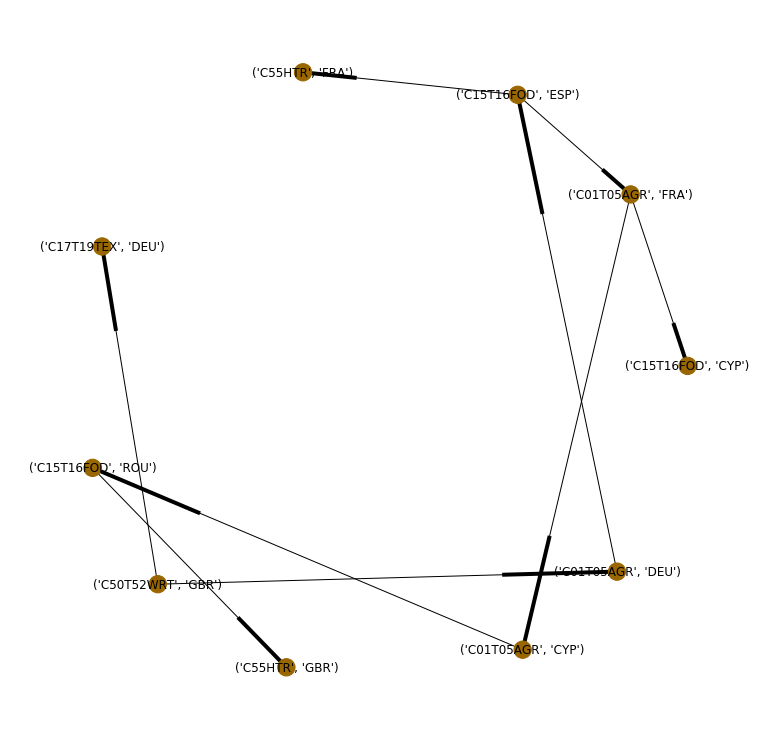

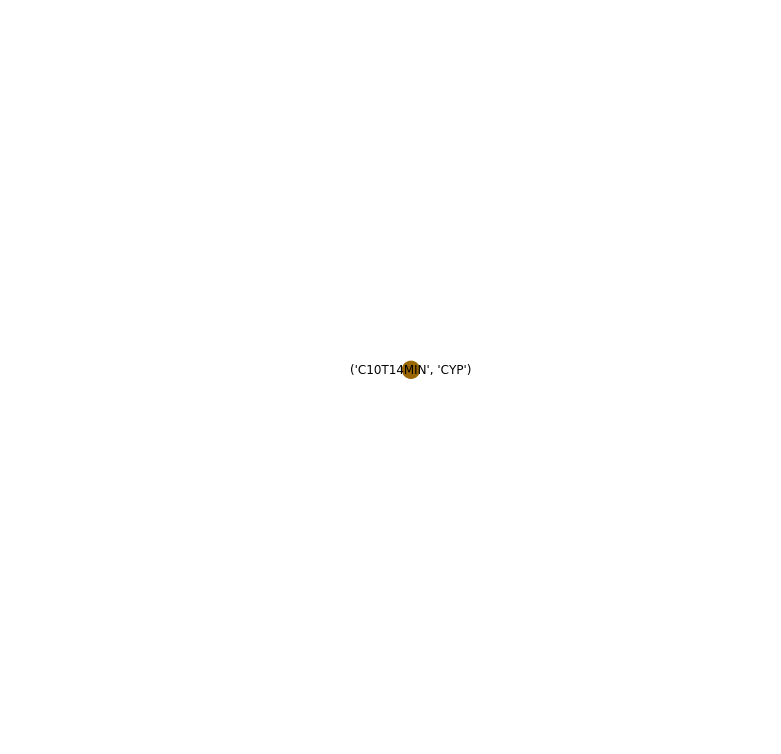

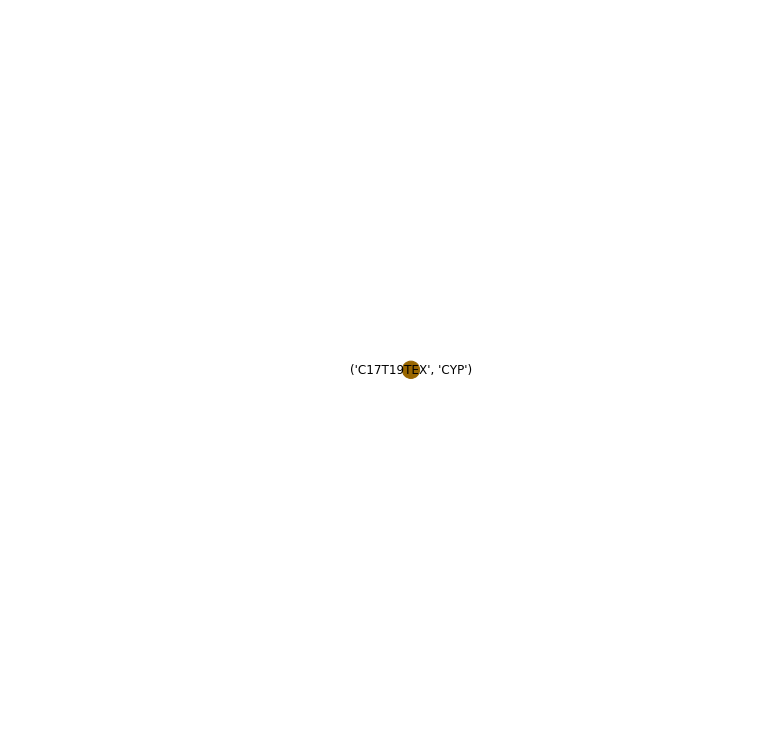

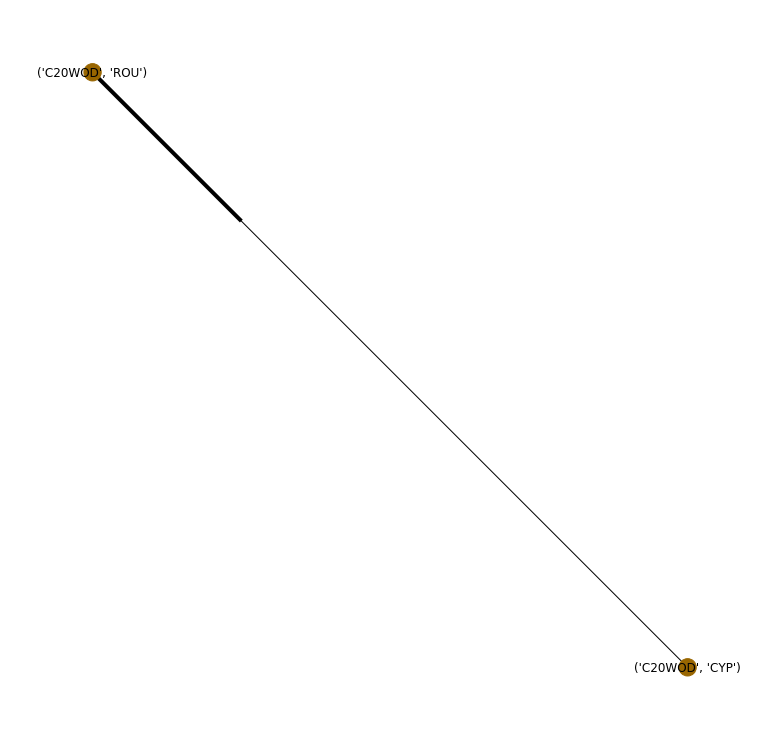

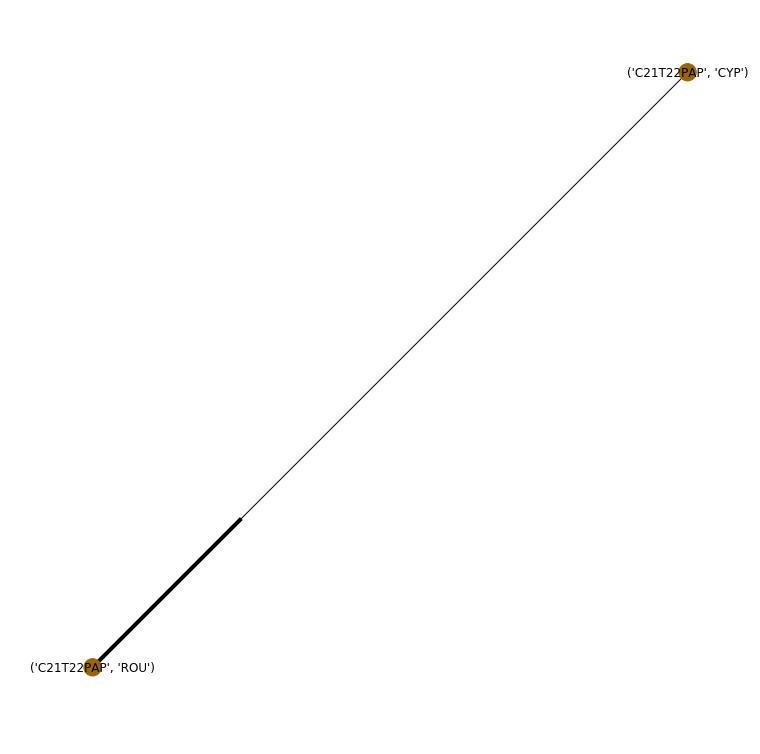

...

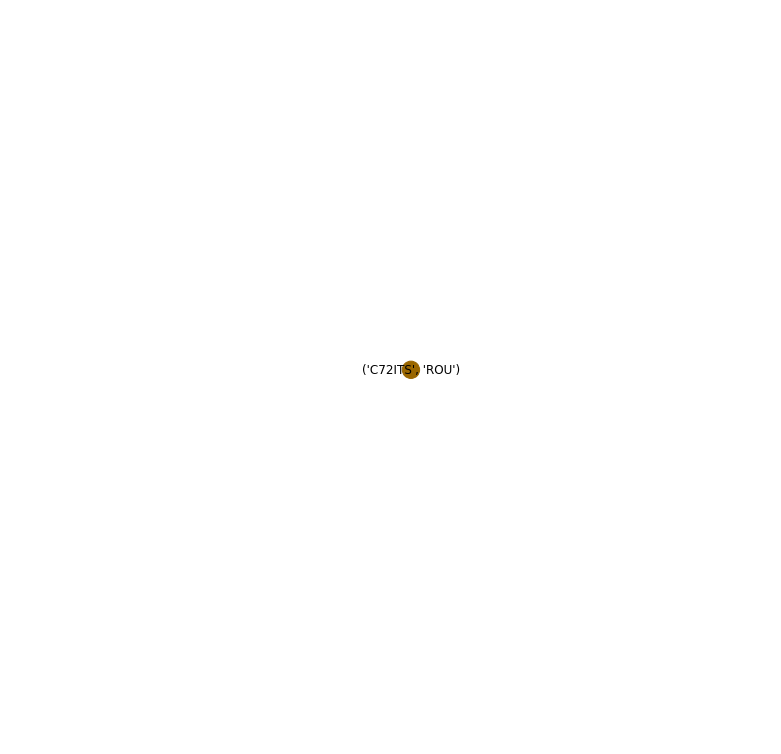

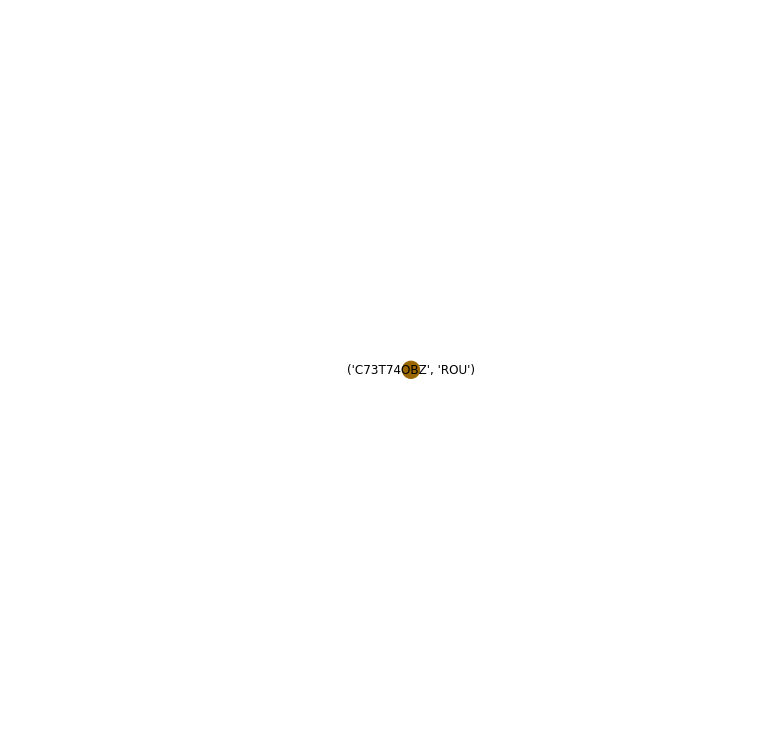

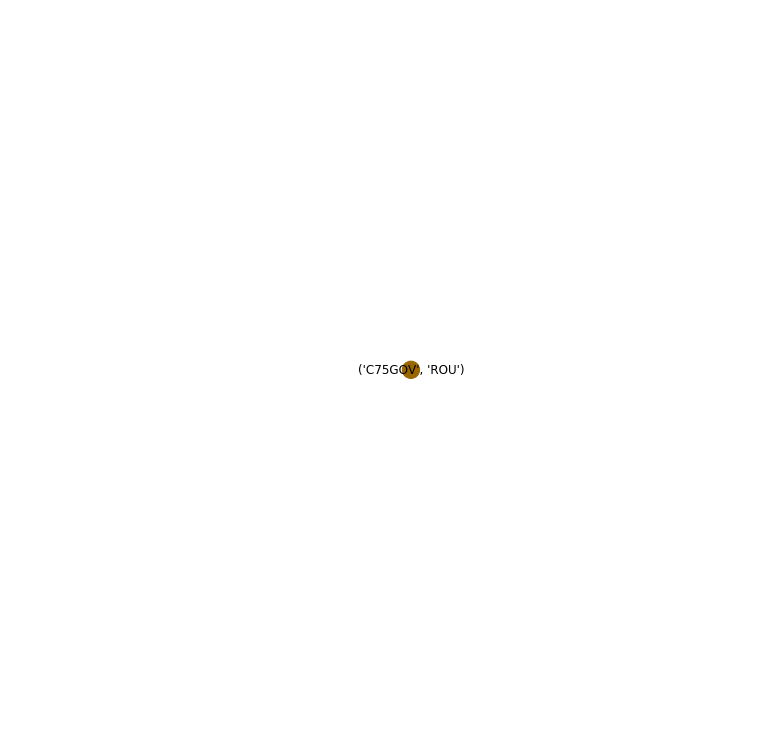

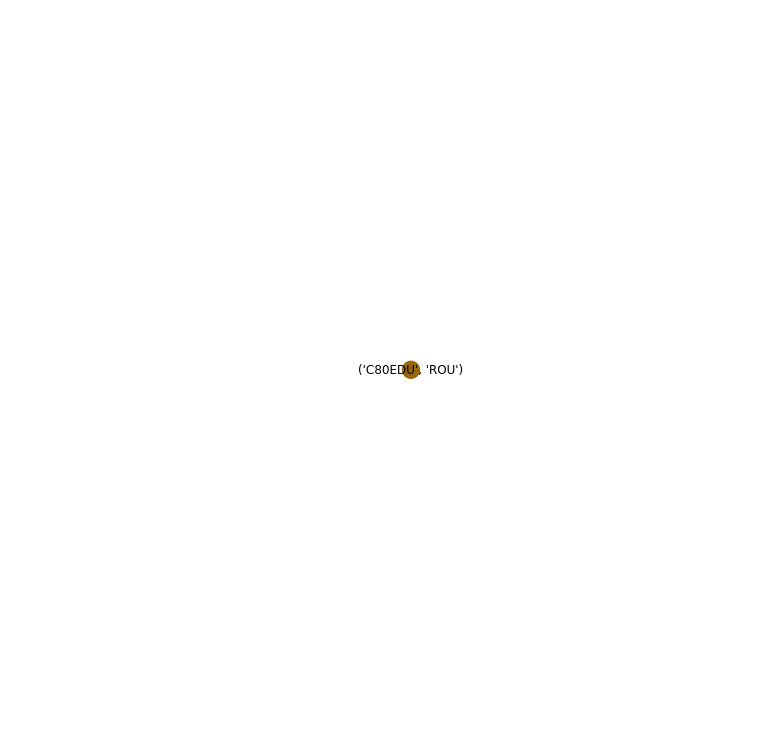

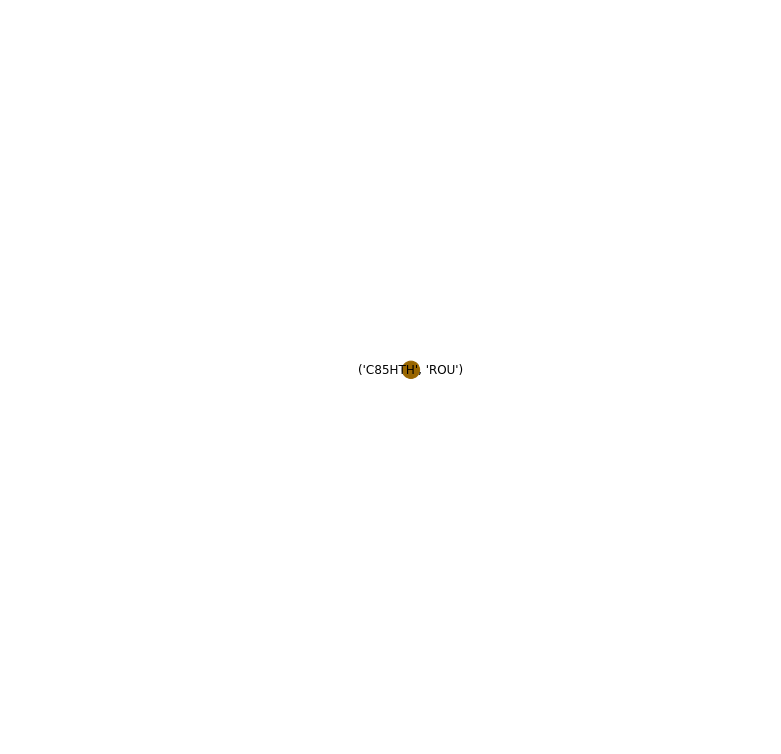

In [29]:
from colour import Color

# community_index = gn_partitions[0]
# countries =np.unique(nx.get_node_attributes(D, 'country').values()) 

# color_map = {}
# for i in countries:
#     c = Color(pick_for=i)
#     color_map[i]="%s" % c

color_map = {}
color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

for i in range(len(community_index)):
    nodes_to_draw = []
    for n in list(community_index)[i]:
        nodes_to_draw.append(n)
    community1 = D.subgraph(nodes_to_draw)
    for node in community1.nodes():
        community1.node[node]['sector'] = sectors[node]
    labels_community=dict((n,(d['sector'], d['country'])) for n,d in community1.nodes(data=True))
    plt.figure(figsize = (10,10))
    nx.draw(community1, labels = labels_community, node_color = [color_map[D.node[node]['country']] for node in D])
    plt.show()

In [83]:
len(gn_partitions)

27

In [63]:
node_shape (string, optional (default=’o’)

SyntaxError: invalid syntax (<ipython-input-63-72bf46306113>, line 1)

In [4]:
weights = nx.get_edge_attributes(D, 'weight').values()
#color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066', 'ESP': '#FF33CC', 'ROU':'r', 'CYP':'#996600'} 

color_map = {'FRA':'b', 'GBR':'#FF0099', 'DEU':'#660066' }
d = nx.degree(D)
shapes =  ['o', 'v', 'd',]


plt.figure(figsize = (120,120))

nx.draw(D, width = weights*20,
        node_color = [color_map[D.node[node]['country']] for node in D],
        node_size=[v * 100 for v in d.values()],
        node_shape = [s for s in shapes])


plt.title('Global Value Chains Sample Network')

france = mpatches.Patch(color = 'b', label = 'France')
britain =  mpatches.Patch(color = '#FF0099', label = 'Great Britain')
germany =  mpatches.Patch(color = '#660066', label = 'Germany')

plt.legend(handles=[france, britain, germany], prop={'size':200})
plt.show()

2

In [ ]:
##load from saved array
#np.save(file = 'gn_partition.npy',arr = list(gn_partition))
#gn_partition = np.load('gn_partition.npy')


In [13]:
gn_partition = list(gn_partition)
values = [gn_partition.get(node) for node in D.nodes()]
nx.draw_spring(D, cmap = plt.get_cmap('jet'), node_color = values, node_size=30, with_labels=False)

plt.show()

AttributeError: 'list' object has no attribute 'get'

In [20]:
list(gn_partition)[0]

KeyboardInterrupt: 

#### LIST OF Things to do

- for each community to look at the share of edges that connect 2 different countries
- calculate the average across all communities
    * repeat for different sectors
- loop across all years and create a plot indicating change of inter-country/inter-industry transaction

